<a href="https://colab.research.google.com/github/Enochkranthi/Deep-Learning/blob/main/topic_modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing Libraries

In [ ]:
pip install Top2Vec

In [ ]:
pip install BERTopic

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

import spacy
import nltk
from nltk.corpus import stopwords

from wordcloud import WordCloud
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel
from gensim.models import Phrases

from sklearn.decomposition import LatentDirichletAllocation
from sklearn.decomposition import NMF
from bertopic import BERTopic
from top2vec import Top2Vec

## Load csv data using Pandas

In [4]:

df = pd.read_csv('/content/abcnews-date-text-mod.csv')
df

,publish_date,headline_text
0,20030219.0,aba decides against community broadcasting lic...
1,20030219.0,act fire witnesses must be aware of defamation
2,20030219.0,a g calls for infrastructure protection summit
3,20030219.0,air nz staff in aust strike for pay rise
4,20030219.0,air nz strike to affect australian travellers
...,...,...
1250427,NaN,NaN
1250428,NaN,NaN
1250429,NaN,NaN
1250430,NaN,NaN


In [5]:
# check for null values
df.isnull().sum()

publish_date      6248
headline_text    12478
dtype: int64

In [6]:
# drop all null value rows
df = df.dropna()

In [7]:
df.isnull().sum()

publish_date     0
headline_text    0
dtype: int64

## Text preprocessing

In [8]:
nltk.download('stopwords')
nltk.download('omw-1.4')
nltk.download('wordnet')
wn = nltk.WordNetLemmatizer()

# Remove stopwords
stopwords = nltk.corpus.stopwords.words('english')
df['headines_without_stopwords'] = df['headline_text'].apply(lambda x: ' '.join([w for w in x.split() if w.lower() not in stopwords]))


#Lemmatization is the grouping together of different forms of the same word
df['headlines_lemmetized'] = df['headines_without_stopwords'].apply(lambda x: ' '.join([wn.lemmatize(w) for w in x.split() if w not in stopwords]))


df.head()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


,publish_date,headline_text,headines_without_stopwords,headlines_lemmetized
0,20030219.0,aba decides against community broadcasting lic...,aba decides community broadcasting licence,aba decides community broadcasting licence
1,20030219.0,act fire witnesses must be aware of defamation,act fire witnesses must aware defamation,act fire witness must aware defamation
2,20030219.0,a g calls for infrastructure protection summit,g calls infrastructure protection summit,g call infrastructure protection summit
3,20030219.0,air nz staff in aust strike for pay rise,air nz staff aust strike pay rise,air nz staff aust strike pay rise
4,20030219.0,air nz strike to affect australian travellers,air nz strike affect australian travellers,air nz strike affect australian traveller


# Topic Modelling

#### In the below block of code I have built 6 models each with topic numbers as [10,25,50,100,150,200] and claculated the coherence for each model.I have left the code in comments as it would to take a lot time to do computation on different topic numbers.However I have trained it for a long time and observed that as the number of topics increases the coherence increases and the coherence score was good for 100 topic. So I have used 100 as the number of topics. However a discussion with domain expert would be more beneficial 


In [9]:
# from gensim.models.ldamodel import LdaModel
# from gensim.models.coherencemodel import CoherenceModel
# from pprint import pprint
# from gensim.corpora.dictionary import Dictionary
# import gensim.corpora as corpora
# import gensim
# from gensim.utils import simple_preprocess

# def sent_to_words(sentences):
#     for sentence in sentences:
#         # deacc=True removes punctuations
#         yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))

# x = data['headline_text'].values.tolist()
# data_words = list(sent_to_words(x))

# # Create Dictionary
# id2word = corpora.Dictionary(data_words)

# # Create Corpus
# texts = data_words

# # Term Document Frequency
# corpus = [id2word.doc2bow(text) for text in texts]
# dictionary = Dictionary(data_words)
# # Build LDA model
# coherence_score_list = []
# for i in [10,25,50,100,150,200]:
#   lda_model = gensim.models.LdaMulticore(corpus=corpus,
#                                         id2word=id2word,
#                                         num_topics=i)
#   coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words, dictionary=dictionary, coherence='c_v')
#   coherence_lda = coherence_model_lda.get_coherence()
#   coherence_score_list.append(coherence_lda)
#   print('\nCoherence Score: ', coherence_lda)

# # Print the Keyword in the 10 topics
# pprint(lda_model.print_topics())
# doc_lda = lda_model[corpus]

## 1. Latent Dirichlet Allocation

#### LDA is a generative probabilistic model for collections of discrete data such as text corpora. LDA is a three-level hierarchical Bayesian model, in which each item of a collection is modeled as a finite mixture over an underlying set of topics. Each topic is, in turn, modeled as an infinite mixture over an underlying set of topic probabilities.

### CountVectorizer

Count Vectorizer is used to transform a given text into a vector on the basis of the frequency (count) of each word that occurs in the entire text

In [10]:
all_words = df.headline_text
cv = CountVectorizer(max_df = 0.9, min_df = 2,stop_words = "english", max_features = 5000)
cv.fit(all_words)


bag_of_words = cv.fit_transform(all_words)
vocab = cv.get_feature_names()

### Build LDA model with CountVectorizer and 100 topics

In [11]:
lda = LatentDirichletAllocation(n_components =100, learning_method="batch",
                                max_iter=1, random_state=0)

document_topics = lda.fit_transform(bag_of_words)

### Display top 10 words from each topic

In [12]:
for i, comp in enumerate(lda.components_):
    vocab_comp = zip(vocab, comp)
    sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:10]
    print("Topic "+str(i)+": ")
    for t in sorted_words:
        print(t[0],end=" ")
    print("\n")

Topic 0: 
new police man australia fined pay wa death community changes 

Topic 1: 
court says council nsw death deal group new face calls 

Topic 2: 
community man court residents charges coast rise australia police drug 

Topic 3: 
police man sydney workers new big face council says city 

Topic 4: 
set new wa murder talks trial interview death police qld 

Topic 5: 
police court new man mp calls wa murder drought missing 

Topic 6: 
police man govt urged nsw qld perth sex weather new 

Topic 7: 
man murder interview school police govt abc qld power council 

Topic 8: 
health court charged man police new boost home govt regional 

Topic 9: 
police new nsw wa says news abc inquiry australian health 

Topic 10: 
police ban man says sydney water calls charged wa sa 

Topic 11: 
new govt interview man council police sa urged hospital qld 

Topic 12: 
election coronavirus house court canberra man return says world australia 

Topic 13: 
council plan win court new man report coronavirus de

### Helper function to plot word cloud

In [13]:
# Generate a word cloud image for given topic
def draw_word_cloud(index):
  imp_words_topic=""
  comp=lda.components_[index]
  vocab_comp = zip(vocab, comp)
  sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:50]
  for word in sorted_words:
    imp_words_topic=imp_words_topic+" "+word[0]

  wordcloud = WordCloud(width = 500, height = 500, min_font_size=10, background_color = 'white').generate(imp_words_topic)
  plt.figure(figsize=(10,7))
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout()
  plt.show()

### Draw Word Cloud for top 25 *topics*

Topic 0 Word CLoud


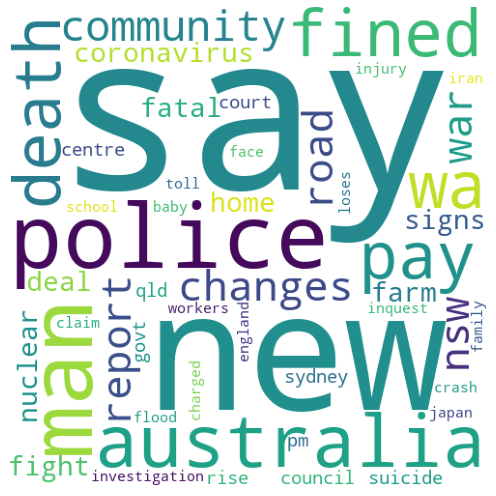

Topic 1 Word CLoud


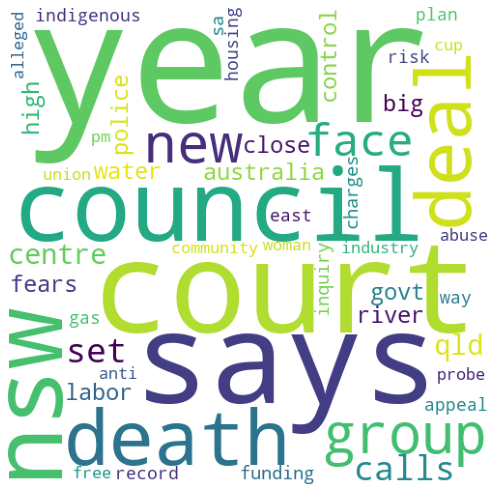

Topic 2 Word CLoud


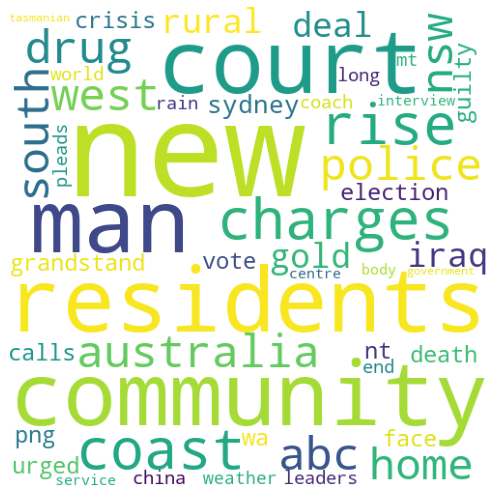

Topic 3 Word CLoud


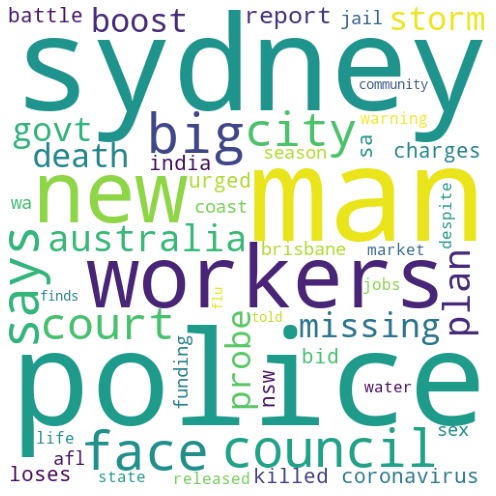

Topic 4 Word CLoud


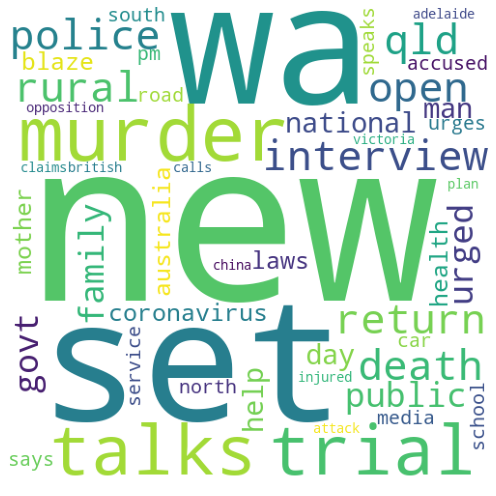

Topic 5 Word CLoud


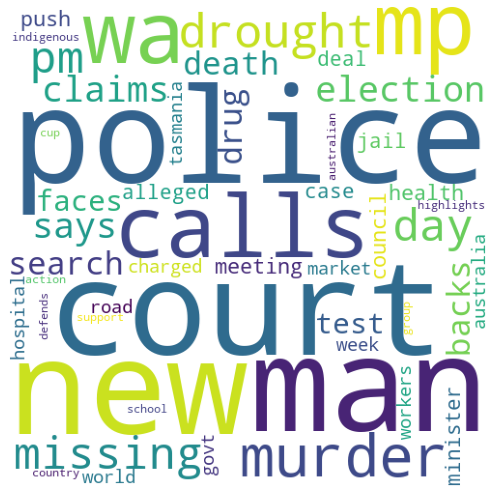

Topic 6 Word CLoud


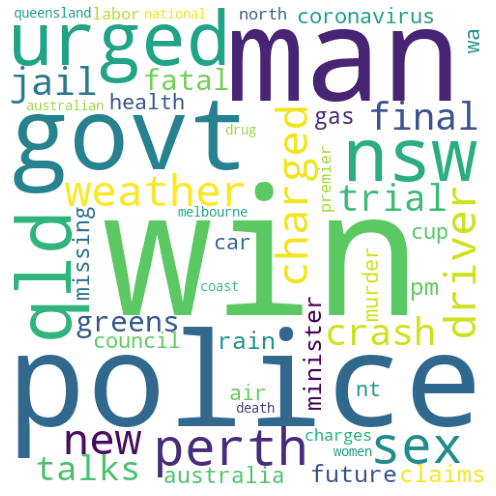

Topic 7 Word CLoud


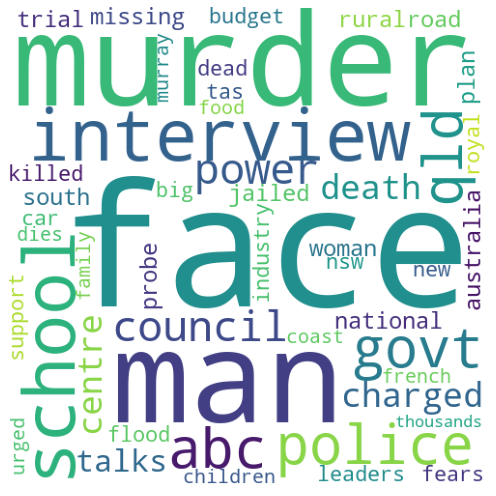

Topic 8 Word CLoud


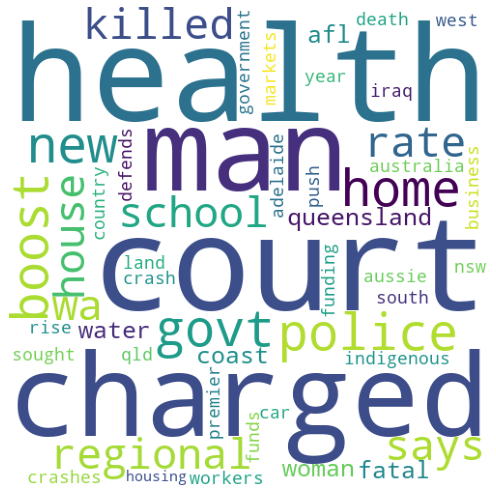

Topic 9 Word CLoud


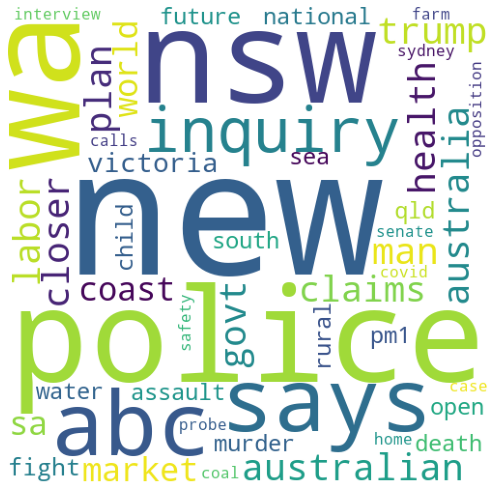

Topic 10 Word CLoud


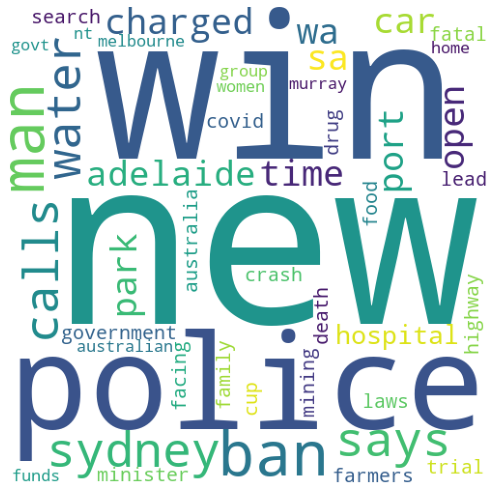

Topic 11 Word CLoud


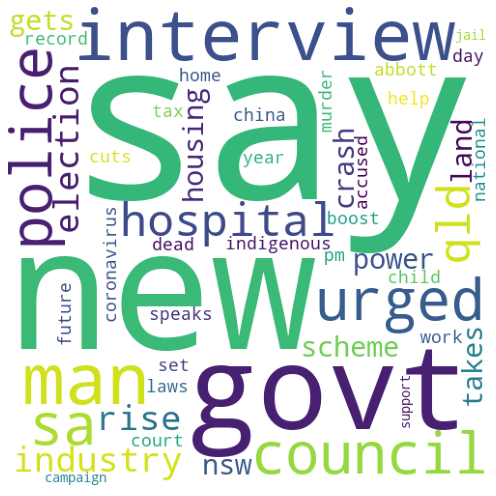

Topic 12 Word CLoud


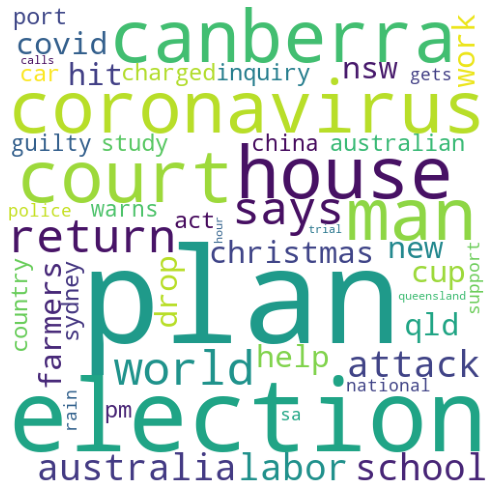

Topic 13 Word CLoud


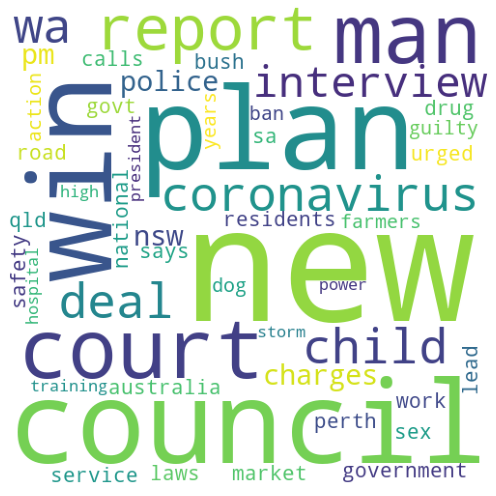

Topic 14 Word CLoud


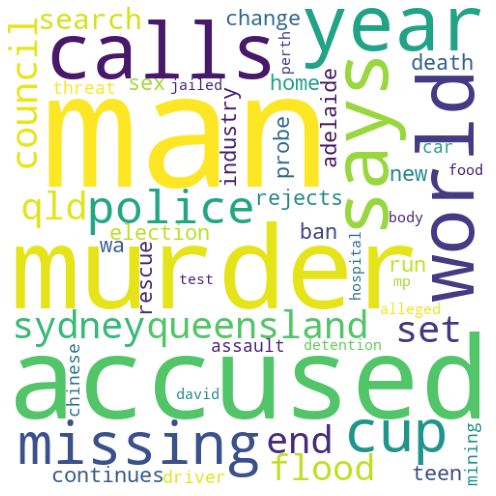

Topic 15 Word CLoud


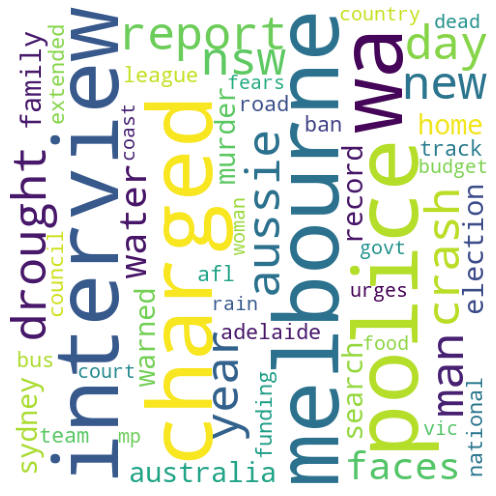

Topic 16 Word CLoud


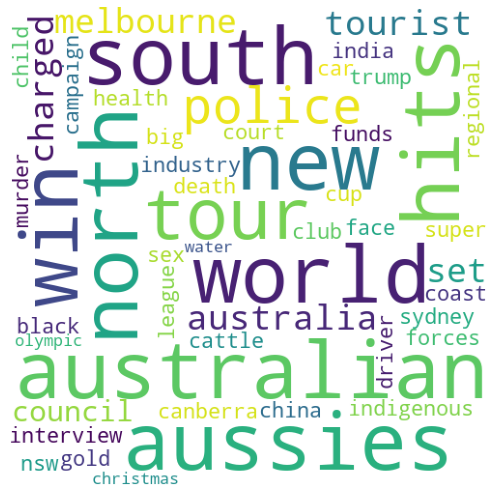

Topic 17 Word CLoud


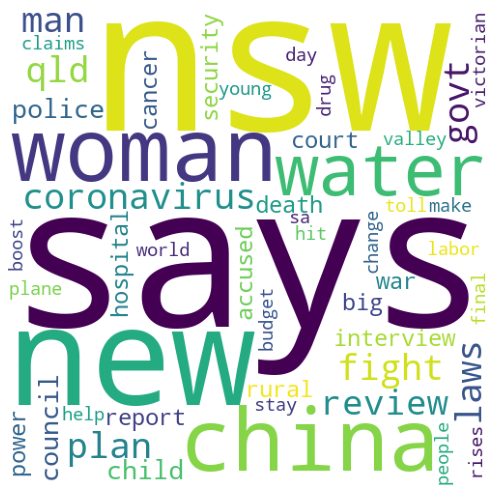

Topic 18 Word CLoud


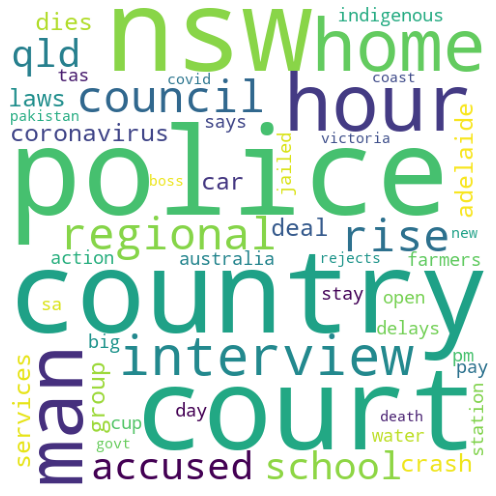

Topic 19 Word CLoud


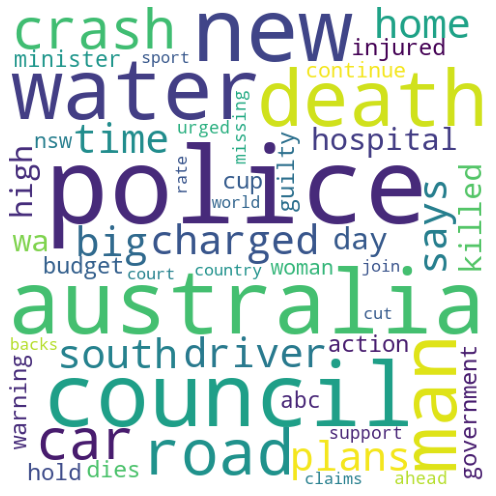

Topic 20 Word CLoud


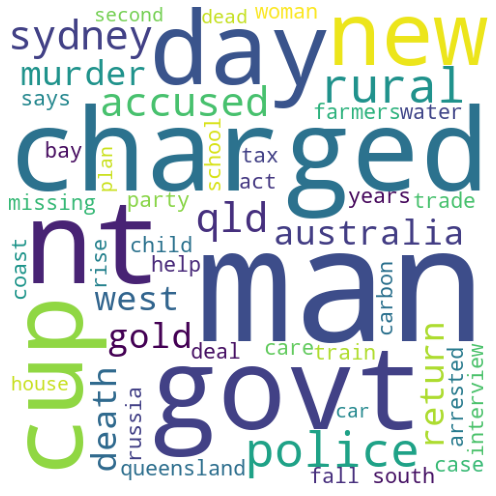

Topic 21 Word CLoud


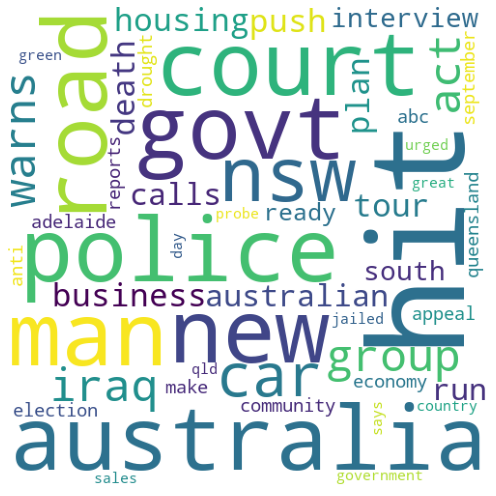

Topic 22 Word CLoud


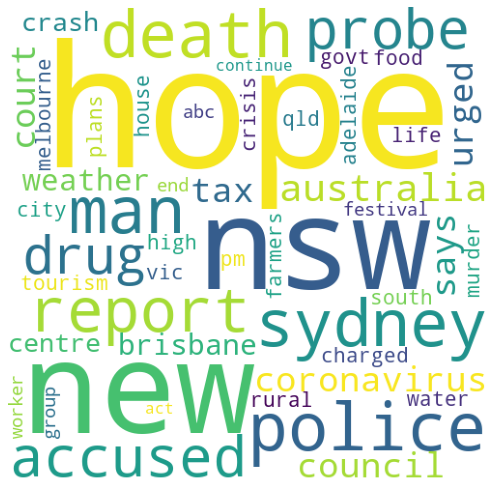

Topic 23 Word CLoud


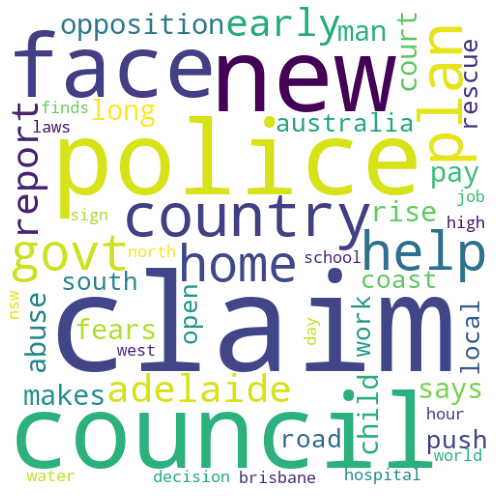

Topic 24 Word CLoud


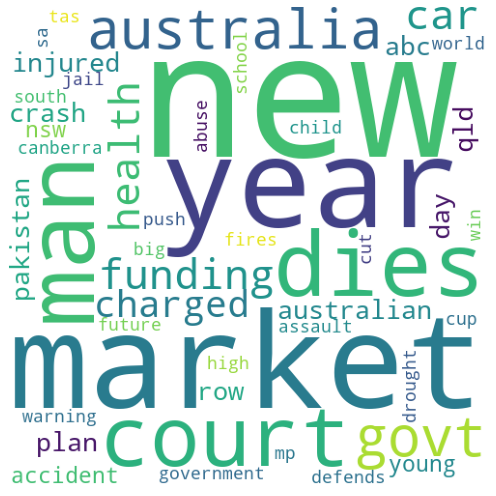

In [14]:
for i in range(25):
    print(f'Topic {i} Word CLoud')
    draw_word_cloud(i)

### TfidfVectorizer

In information retrieval, tf–idf or TFIDF, short for term frequency–inverse document frequency, is a numerical statistic that is intended to reflect how important a word is to a document in a collection or corpus

In [15]:
all_words = df.headline_text


# create object
tfidf = TfidfVectorizer(max_df = 0.9, min_df = 2,stop_words = "english", max_features = 5000)
 
# get tf-df values
bag_of_words = tfidf.fit_transform(all_words)

vocab = tfidf.get_feature_names()



#### Build the model with Tf-idf vectorizer

In [16]:
lda = LatentDirichletAllocation(n_components =100, learning_method="batch",
                                max_iter=1, random_state=0)

document_topics = lda.fit_transform(bag_of_words)

### Display top 10 words from each topic

In [17]:
topic_words_lda = []

for i, comp in enumerate(lda.components_):
    topic_words_lda_each = []
    vocab_comp = zip(vocab, comp)
    sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:10]
    print("Topic "+str(i)+": ")
    for t in sorted_words:
        topic_words_lda_each.append(t[0])
        print(t[0],end=" ")
    print("\n")
    topic_words_lda.append(topic_words_lda_each)

Topic 0: 
new police man fined pay australia death wa community changes 

Topic 1: 
court says council nsw death new deal police group water 

Topic 2: 
man community court residents police charges new rise coast drug 

Topic 3: 
police man new workers sydney face big council court city 

Topic 4: 
set new murder wa police trial talks death news rural 

Topic 5: 
court police new man mp calls murder missing wa drought 

Topic 6: 
police man urged govt nsw qld new driver perth weather 

Topic 7: 
man murder police school govt qld charged power abc centre 

Topic 8: 
health charged court police man new boost home regional govt 

Topic 9: 
police new news nsw wa says abc inquiry australian national 

Topic 10: 
police ban man charged says calls sydney water sa wa 

Topic 11: 
new govt police man council sa interview hospital urged industry 

Topic 12: 
election house coronavirus canberra man court return school christmas world 

Topic 13: 
council new man plan win court police deal report

### Draw Word Cloud for top 25 topics

Topic 0 Word CLoud


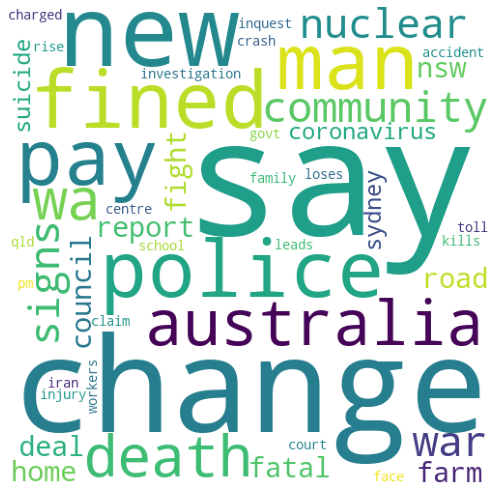

Topic 1 Word CLoud


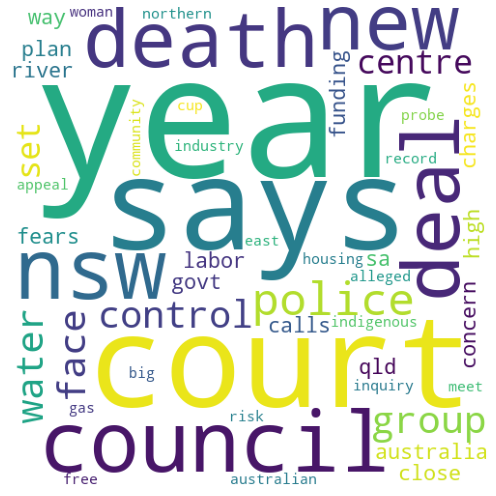

Topic 2 Word CLoud


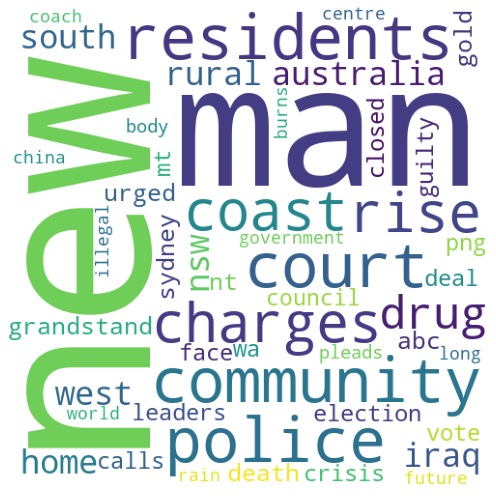

Topic 3 Word CLoud


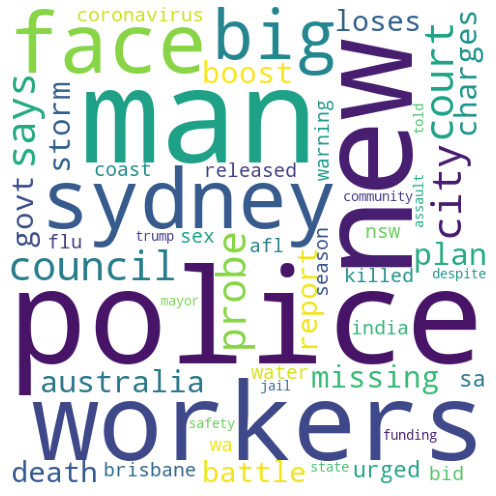

Topic 4 Word CLoud


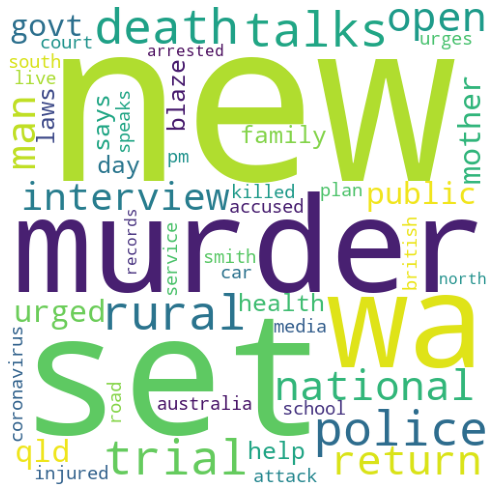

Topic 5 Word CLoud


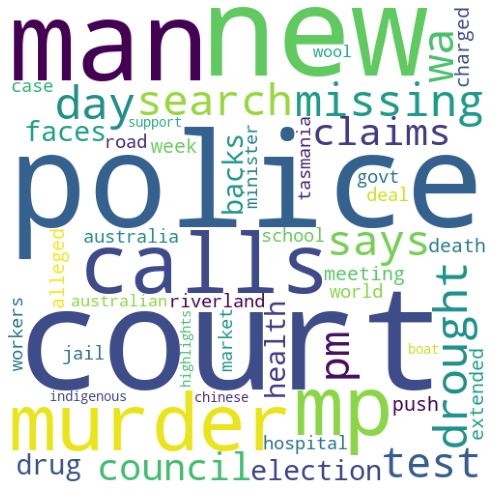

Topic 6 Word CLoud


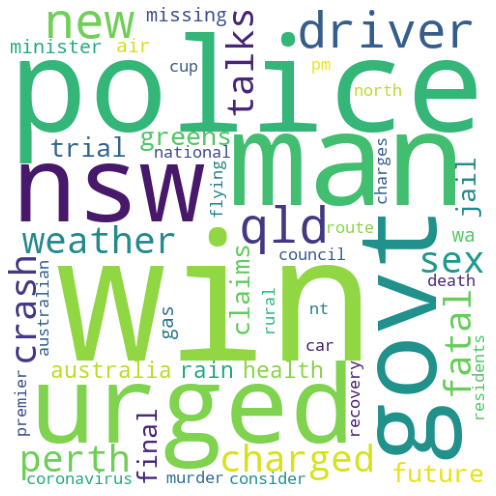

Topic 7 Word CLoud


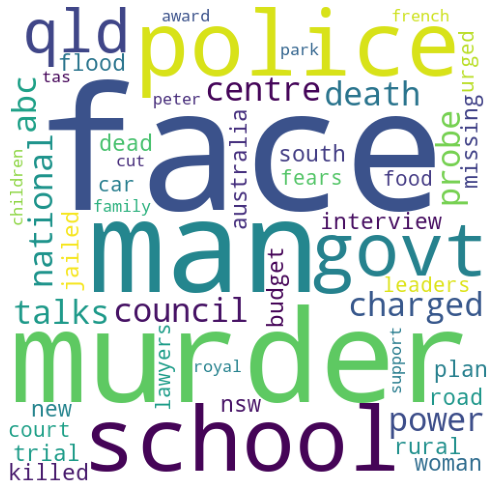

Topic 8 Word CLoud


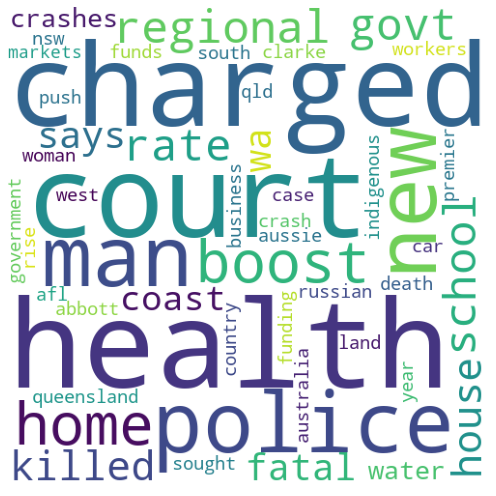

Topic 9 Word CLoud


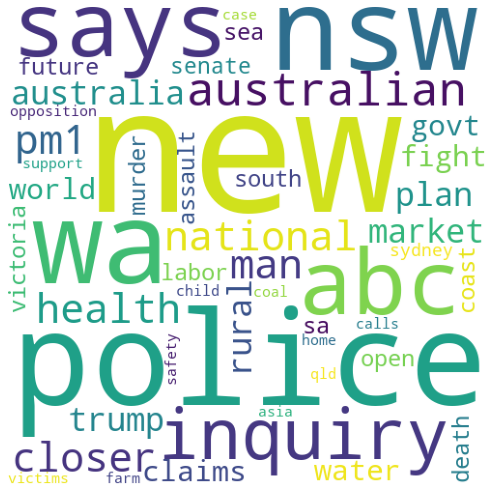

Topic 10 Word CLoud


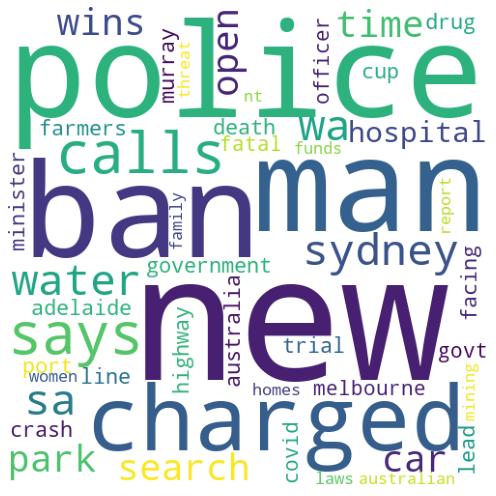

Topic 11 Word CLoud


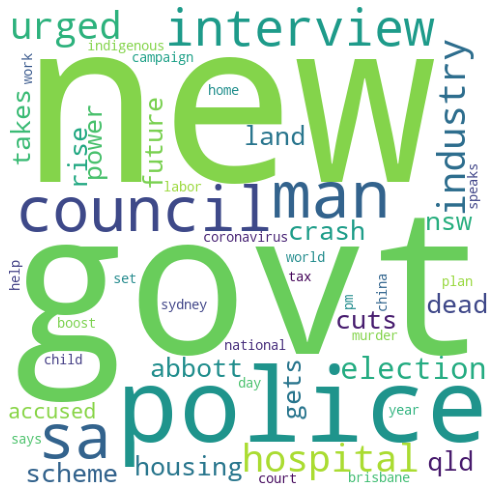

Topic 12 Word CLoud


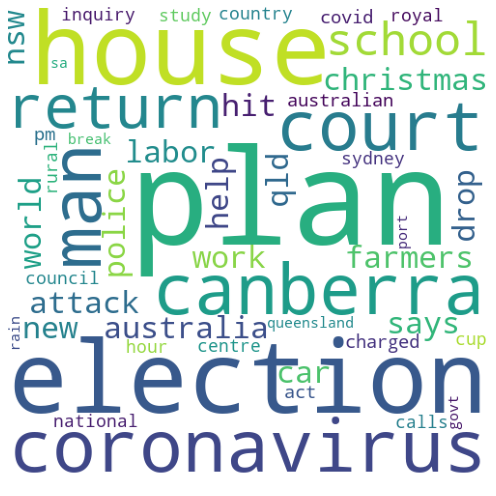

Topic 13 Word CLoud


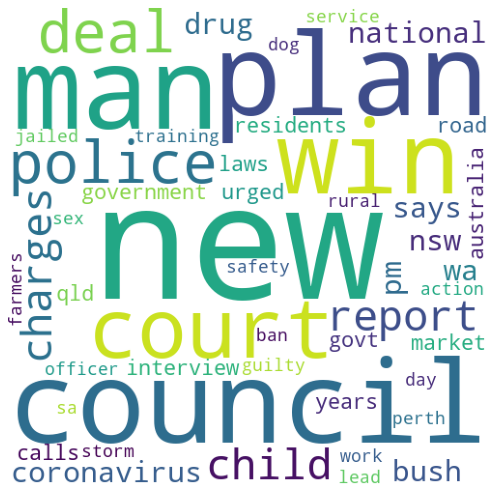

Topic 14 Word CLoud


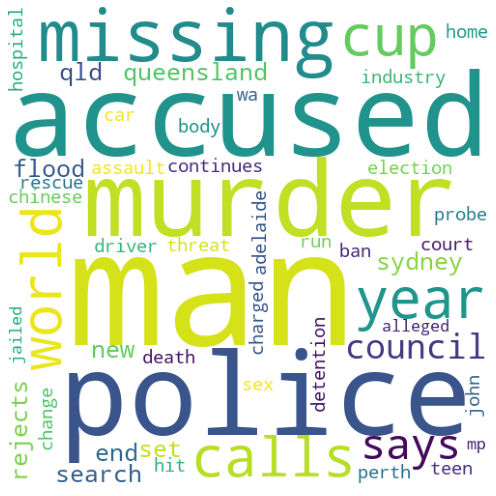

Topic 15 Word CLoud


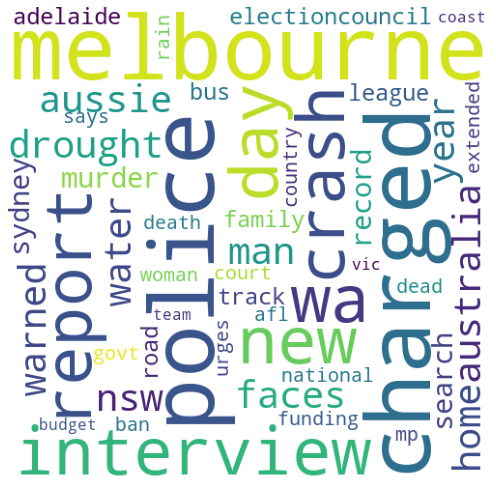

Topic 16 Word CLoud


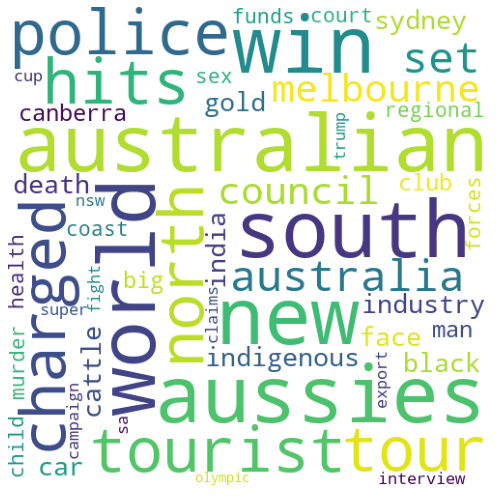

Topic 17 Word CLoud


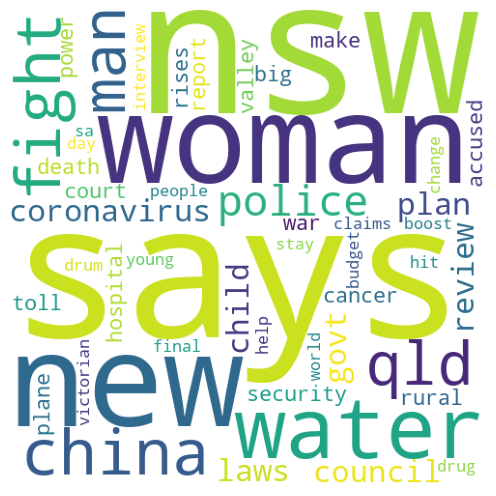

Topic 18 Word CLoud


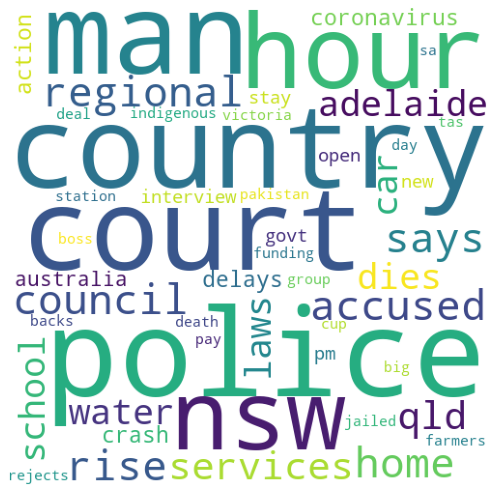

Topic 19 Word CLoud


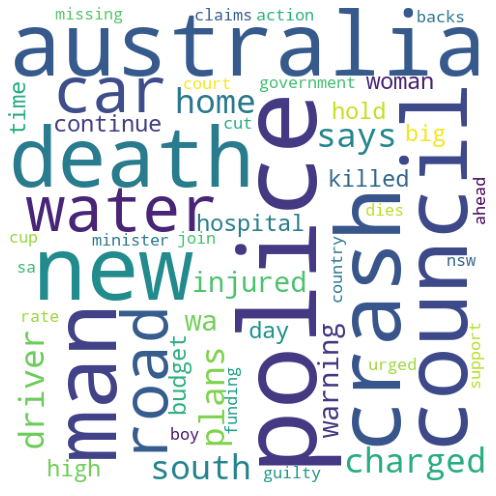

Topic 20 Word CLoud


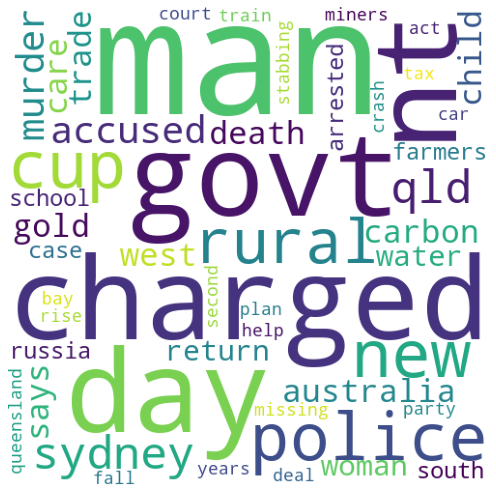

Topic 21 Word CLoud


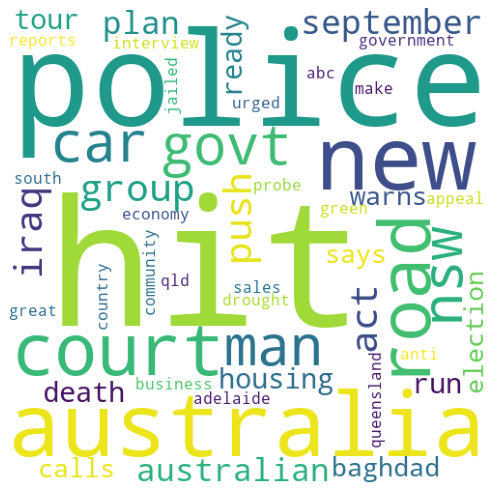

Topic 22 Word CLoud


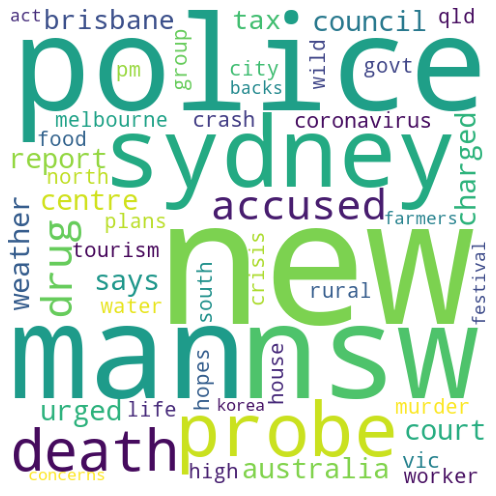

Topic 23 Word CLoud


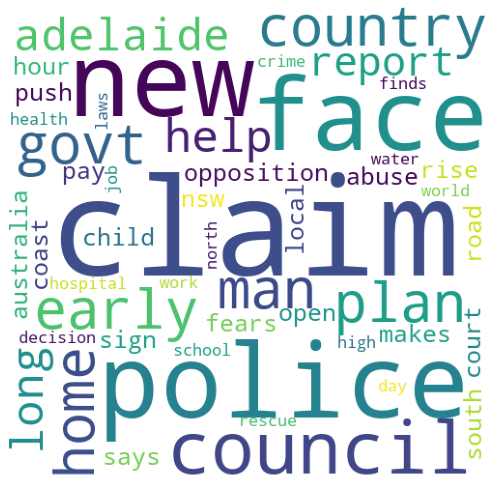

Topic 24 Word CLoud


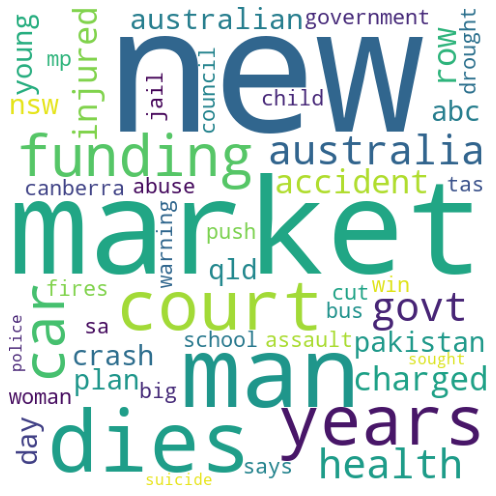

In [18]:
for i in range(25):
    print(f'Topic {i} Word CLoud')
    draw_word_cloud(i)

## 2. Non Negative Matrix Factorization

Non-Negative Matrix Factorization is a statistical method that helps us to reduce the dimension of the input corpora. Internally, it uses the factor analysis method to give comparatively less weightage to the words that are having less coherence.

### Build the model




In [21]:
all_words = df.headline_text


# create object
tfidf = TfidfVectorizer(max_df = 0.9, min_df = 2,stop_words = "english", max_features = 1000)
 
# get tf-df values
bag_of_words = tfidf.fit_transform(all_words)

vocab = tfidf.get_feature_names()

In [22]:
nmf_model = NMF(n_components=25, random_state=42)

In [23]:
nmf_model.fit(bag_of_words)

NMF(n_components=25, random_state=42)

### Display top 10 words from each topic

In [24]:
for i, comp in enumerate(nmf_model.components_):
    vocab_comp = zip(vocab, comp)
    sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:10]
    print("Topic "+str(i)+": ")
    for t in sorted_words:
        print(t[0],end=" ")
    print("\n")

Topic 0: 
interview extended michael nrl john david james smith andrew afl 

Topic 1: 
police investigate probe search missing hunt officer arrest say shooting 

Topic 2: 
new zealand laws year years cases home centre deal president 

Topic 3: 
man jailed missing arrested guilty dies attack search accused stabbing 

Topic 4: 
says trump pm minister mp labor union opposition wont expert 

Topic 5: 
australia south coronavirus china india cricket live vs covid western 

Topic 6: 
govt urged vic accused nt act sa local funds defends 

Topic 7: 
court accused face told case faces high charges hears appeal 

Topic 8: 
council considers plans land seeks rise mayor rates budget city 

Topic 9: 
australian open market year china dollar south share wins shares 

Topic 10: 
nsw rural country coronavirus hour drought government farmers premier covid 

Topic 11: 
sydney hobart home western house melbourne airport shooting harbour league 

Topic 12: 
water restrictions murray farmers supply residen

### Helper function to plot word cloud

In [25]:
# Generate a word cloud image for given topic
def draw_word_cloud_nmf(index):
  imp_words_topic=""
  comp=nmf_model.components_[index]
  vocab_comp = zip(vocab, comp)
  sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:50]
  for word in sorted_words:
    imp_words_topic=imp_words_topic+" "+word[0]

  wordcloud = WordCloud(width = 500, height = 500, min_font_size=10, background_color = 'white').generate(imp_words_topic)
  plt.figure(figsize=(10,7))
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout()

  plt.show()

### Draw Word Cloud for top 25 topics

Topic 0 Word CLoud


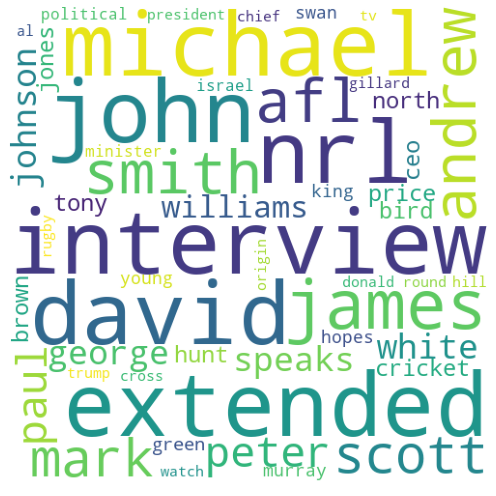

Topic 1 Word CLoud


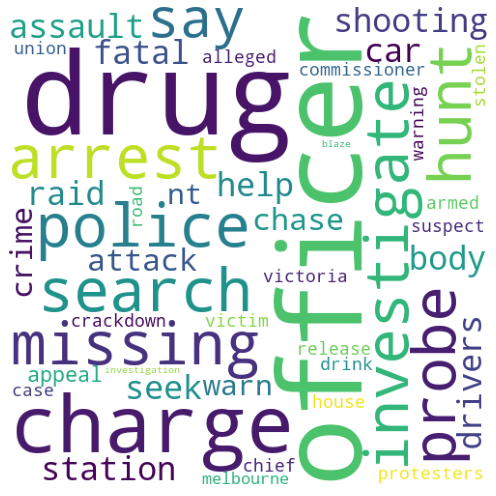

Topic 2 Word CLoud


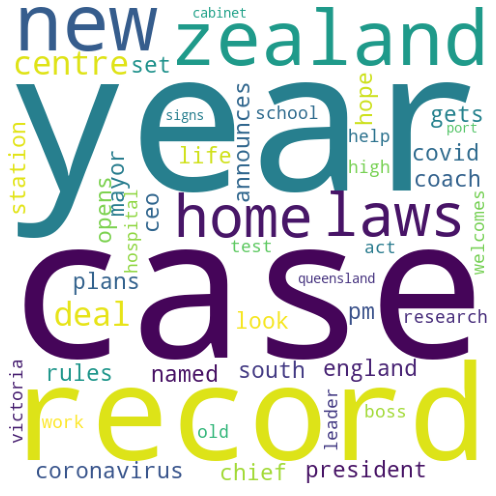

Topic 3 Word CLoud


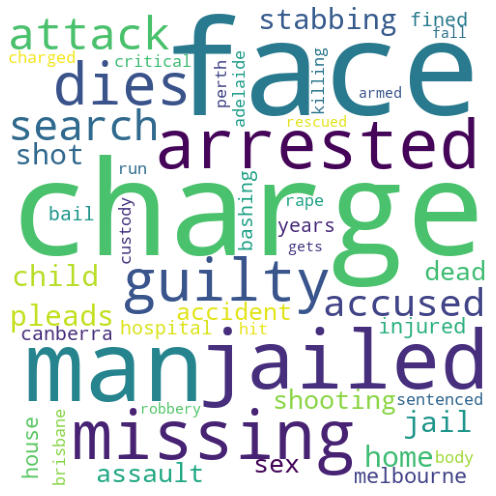

Topic 4 Word CLoud


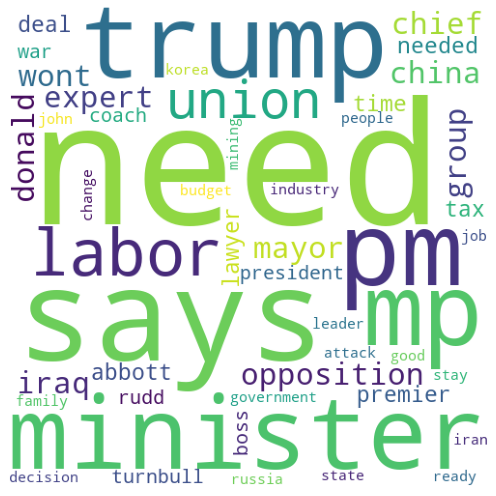

Topic 5 Word CLoud


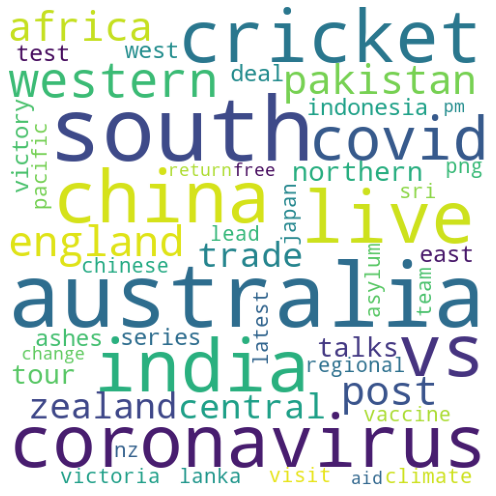

Topic 6 Word CLoud


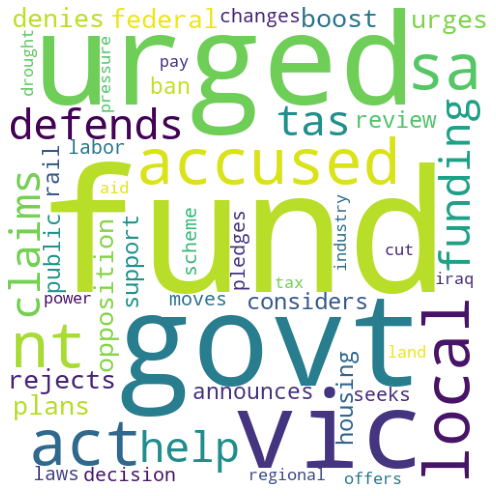

Topic 7 Word CLoud


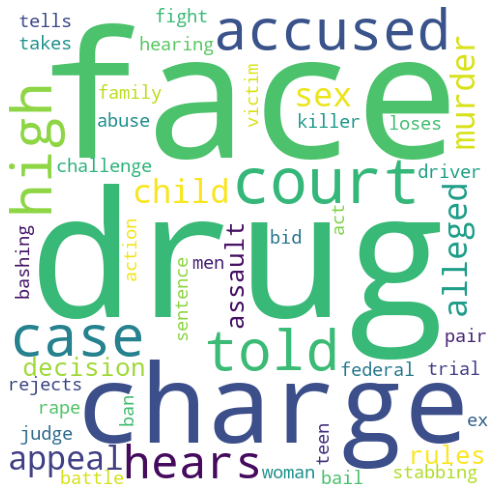

Topic 8 Word CLoud


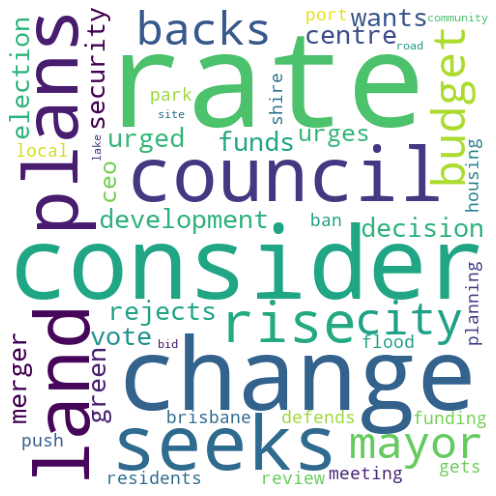

Topic 9 Word CLoud


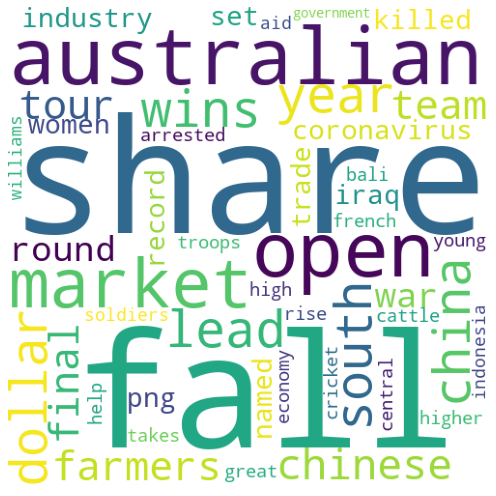

Topic 10 Word CLoud


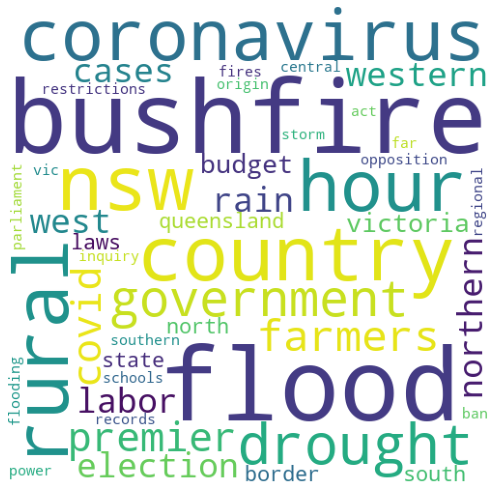

Topic 11 Word CLoud


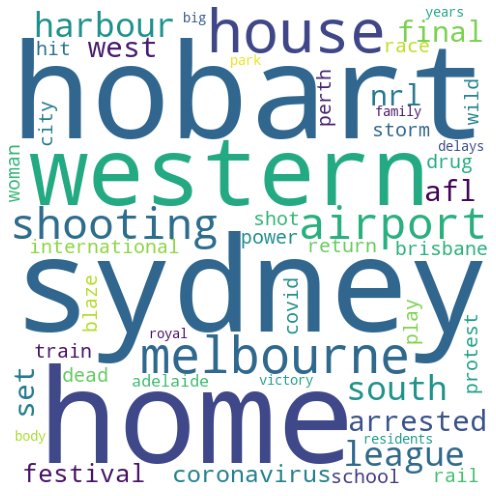

Topic 12 Word CLoud


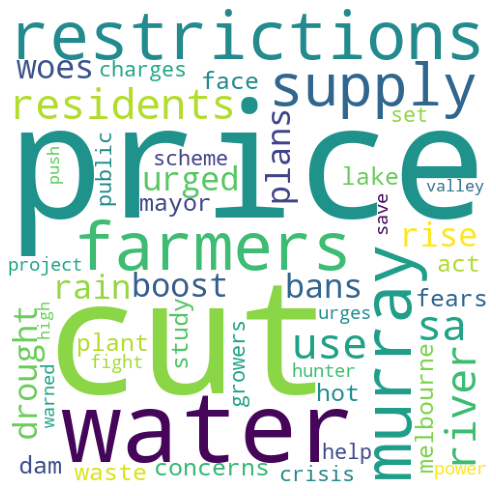

Topic 13 Word CLoud


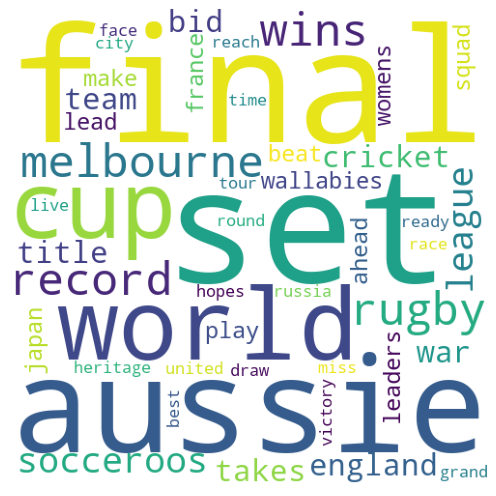

Topic 14 Word CLoud


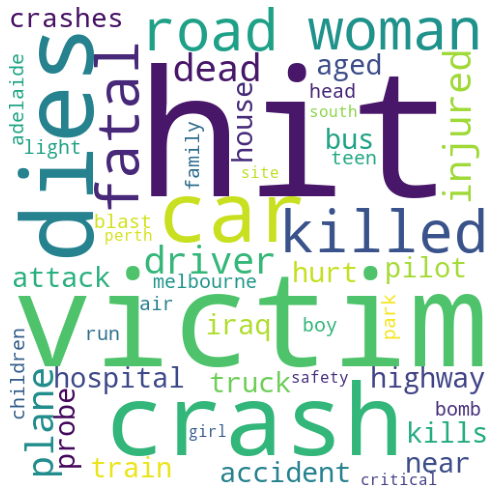

Topic 15 Word CLoud


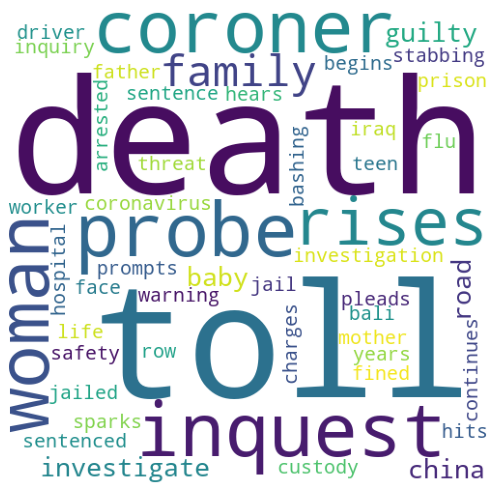

Topic 16 Word CLoud


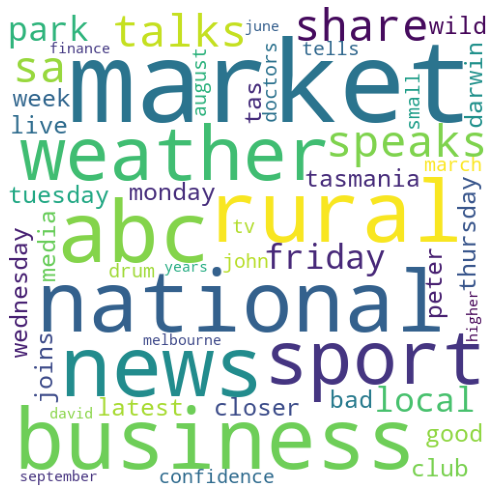

Topic 17 Word CLoud


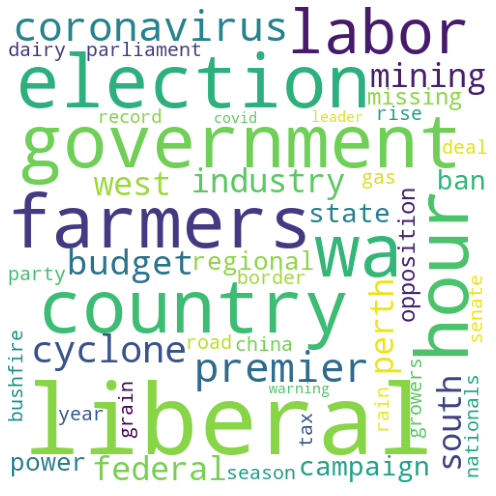

Topic 18 Word CLoud


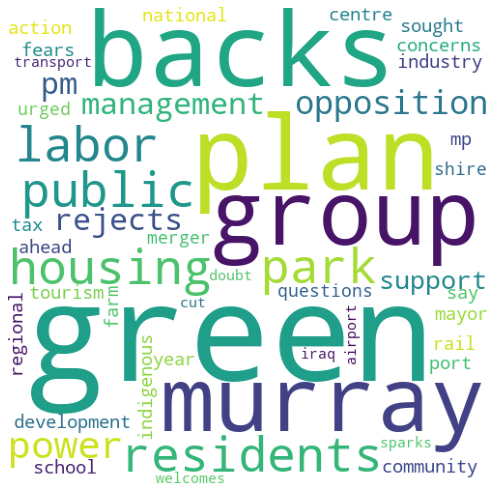

Topic 19 Word CLoud


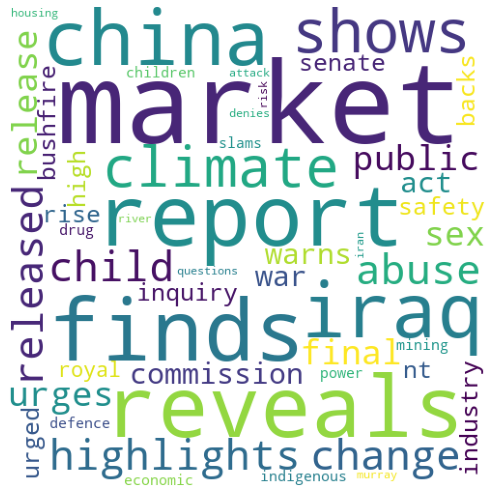

Topic 20 Word CLoud


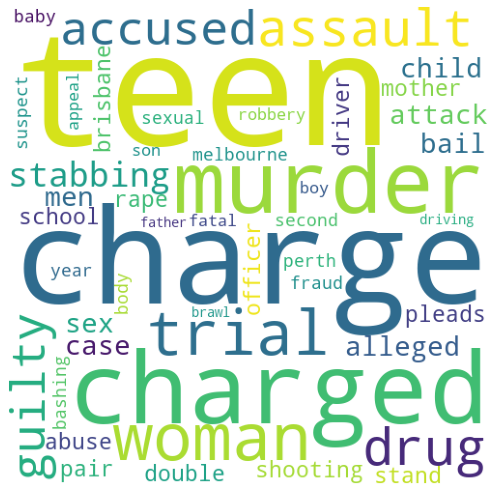

Topic 21 Word CLoud


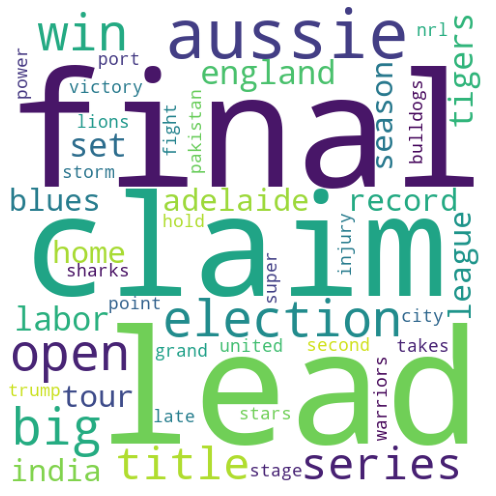

Topic 22 Word CLoud


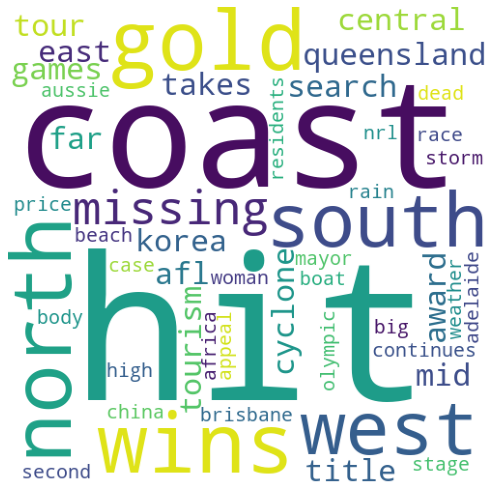

Topic 23 Word CLoud


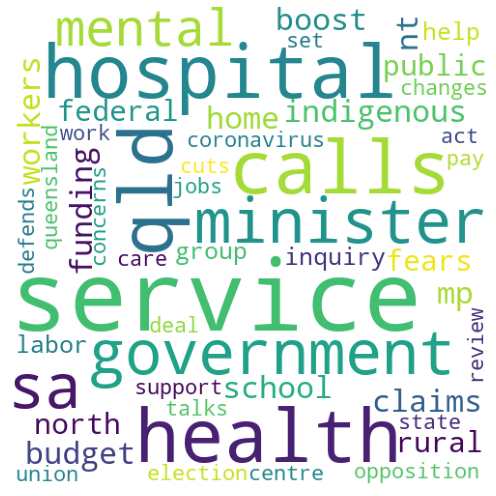

Topic 24 Word CLoud


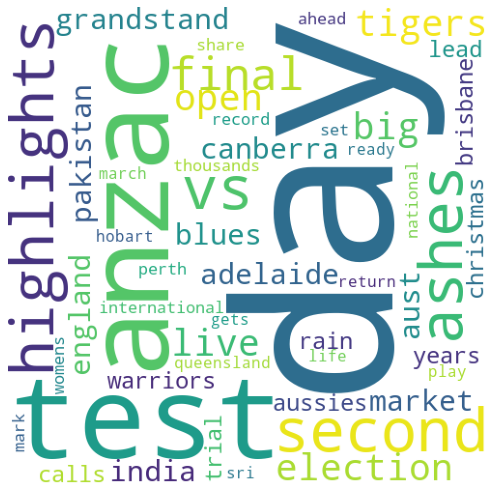

In [26]:
for i in range(25):
    print(f'Topic {i} Word CLoud')
    draw_word_cloud_nmf(i)

## 3. BERTopic

#### BERTopic is a topic modeling technique that leverages transformers and c-TF-IDF to create dense clusters allowing for easily interpretable topics whilst keeping important words in the topic descriptions.

As the Data is of 1Million headlines, considering the computation power and time I have reduced the dataset and built the model using first 20000 sentences. 

In [27]:
docs = df['headline_text'].tolist()
docs = docs[:20000]

In [28]:
def model(docs):
  topic_model = BERTopic(verbose=True, n_gram_range=(1, 3))
  topics, _ = topic_model.fit_transform(docs)

  # Preprocess Documents
  documents = pd.DataFrame({"Document": docs,
                          "ID": range(len(docs)),
                          "Topic": topics})
  documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
  cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)
  topic_words = topic_words = [[words for words, _ in topic_model.get_topic(topic) if words!=''] 
               for topic in range(len(set(topics))-1)]
  vectorizer = topic_model.vectorizer_model
  tokenizer = vectorizer.build_tokenizer()
  #dictionary
  tokens = [doc.split() for doc in docs]
  dictionary = corpora.Dictionary(tokens)
  corpus = [dictionary.doc2bow(token) for token in tokens]


  coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')
  coherence = coherence_model.get_coherence()

  
  return coherence, topic_model, topics


Build the model

In [29]:
coherence, topic_model, topics = model(docs)

Batches:   0%|          | 0/625 [00:00<?, ?it/s]

2022-11-16 20:25:54,523 - BERTopic - Transformed documents to Embeddings
2022-11-16 20:26:48,152 - BERTopic - Reduced dimensionality
2022-11-16 20:26:54,101 - BERTopic - Clustered reduced embeddings


Print Coherence of the BERTopic model

In [30]:
coherence

0.5608735657152186

Display pandas Dataframe with topic, count and top words

In [31]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,6934,-1_to_for_in_of
1,0,511,0_sars_china_pneumonia_cases
2,1,361,1_drought_rain_farmers_rainfall
3,2,348,2_fire_bushfire_blaze_firefighters
4,3,271,3_arsenal_leeds_united_beckham
...,...,...,...
317,316,10,316_woomera_woomera claims_police to look_look...
318,317,10,317_west indies_indies_cricketers_cricketers a...
319,318,10,318_historic_shearers_heritage_listed
320,319,10,319_marina_marina plan_marina development_plan...


Visualize top topic keywords

In [32]:
topic_model.visualize_barchart(top_n_topics=25)

In [33]:
topic_model.visualize_topics()

## 4. Top2Vec

### Top2Vec is an algorithm for topic modeling and semantic search. It automatically detects topics present in text and generates jointly embedded topic, document and word vectors

As the Data is of 1Million headlines, considering the computation power and time I have reduced the dataset and built the model using first 20000 sentences.

### Building Top2Vec model using all-MiniLM-L6-v2 sequence transformer

In [34]:
model = Top2Vec(docs[:20000], embedding_model = 'all-MiniLM-L6-v2',min_count = 0, speed = 'deep-learn', workers = 14)

2022-11-16 20:27:51,912 - top2vec - INFO - Pre-processing documents for training
INFO:top2vec:Pre-processing documents for training
2022-11-16 20:27:52,744 - top2vec - INFO - Downloading all-MiniLM-L6-v2 model
INFO:top2vec:Downloading all-MiniLM-L6-v2 model
2022-11-16 20:27:53,101 - top2vec - INFO - Creating joint document/word embedding
INFO:top2vec:Creating joint document/word embedding
2022-11-16 20:30:49,810 - top2vec - INFO - Creating lower dimension embedding of documents
INFO:top2vec:Creating lower dimension embedding of documents
2022-11-16 20:31:14,729 - top2vec - INFO - Finding dense areas of documents
INFO:top2vec:Finding dense areas of documents
2022-11-16 20:31:15,857 - top2vec - INFO - Finding topics
INFO:top2vec:Finding topics


#### get topic sizes and topic nums

In [35]:
topic_sizes, topic_nums = model.get_topic_sizes()

In [36]:
topic_nums

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

### Print the top 25 topics and the key words

In [37]:
topic_words, word_score, topic_nums = model.get_topics(25)

for words, scores, num in zip(topic_words, word_score, topic_nums):
    print(num)
    print(words)

0
['wickets' 'odi' 'mcgrath' 'cricket' 'villiers' 'crickets' 'wicket'
 'aussies' 'cricketers' 'indies' 'bowled' 'kilda' 'cricketing'
 'collingwood' 'bowlers' 'tendulkar' 'austs' 'batsmen' 'icc' 'batting'
 'turnbull' 'ponting' 'bowler' 'sachin' 'ganguly' 'ashes' 'aust' 'nrl'
 'fremantle' 'aus' 'innings' 'australias' 'anzac' 'essendon' 'brisbanes'
 'chappells' 'aussie' 'lankans' 'rugby' 'adelaides' 'queenslander' 'lanka'
 'chappell' 'pontings' 'fiji' 'unbeaten' 'australians' 'andersson'
 'lankan' 'forster']
1
['sars' 'sarwan' 'sarina' 'sardi' 'quarantines' 'sarthe' 'nam' 'plagues'
 'wmds' 'outbreaks' 'outbreak' 'flu' 'epidemic' 'plague' 'vaccinations'
 'quarantined' 'quarantine' 'missiles' 'radar' 'peacekeeping' 'syrias'
 'burmas' 'wmd' 'ansar' 'smallpox' 'casualties' 'anzacs' 'medics'
 'vaccine' 'ebola' 'dengue' 'cairns' 'vaccines' 'tasmanians' 'fever'
 'pneumonia' 'immunisations' 'servicemen' 'vaccination' 'vietnam'
 'fremantle' 'immunisation' 'immunised' 'missile' 'anzac' 'warns' 'ran

### Print top 10 documents of specific topic

In [38]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num = 15, num_docs = 10)

for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document : {doc_id}, Score : {score}")
    print("-"*50)
    print(doc)
    print("-"*50)
    print()

Document : 12578, Score : 0.8408170938491821
--------------------------------------------------
us army in charge of baghdad
--------------------------------------------------

Document : 9932, Score : 0.8369005918502808
--------------------------------------------------
us forces attacking central baghdad
--------------------------------------------------

Document : 9251, Score : 0.8359042406082153
--------------------------------------------------
difficult warfare ahead in baghdad
--------------------------------------------------

Document : 9474, Score : 0.8304942846298218
--------------------------------------------------
iraqi us forces clash in baghdad
--------------------------------------------------

Document : 6191, Score : 0.8244690299034119
--------------------------------------------------
coalition forces hopeful of reaching baghdad in
--------------------------------------------------

Document : 9052, Score : 0.8210057616233826
---------------------------------------

### Word Cloud for the top 25 topics

/usr/local/lib/python3.7/dist-packages/top2vec/Top2Vec.py:2698: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



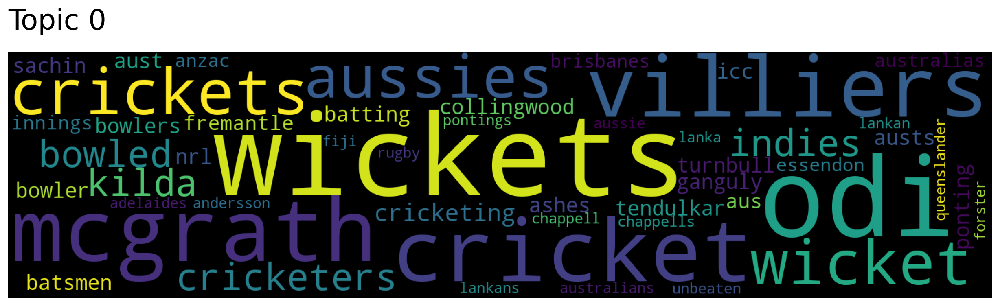

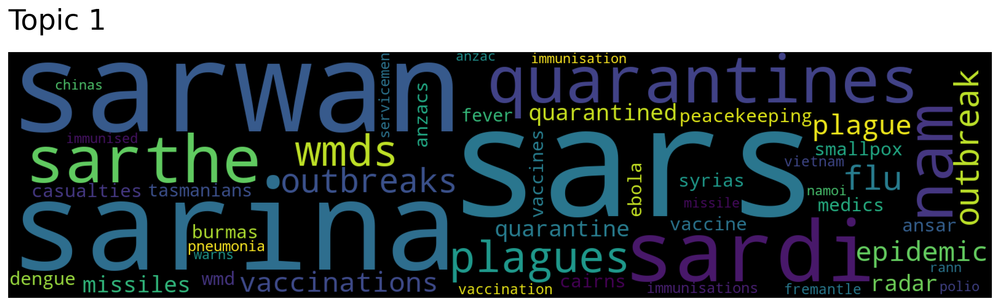

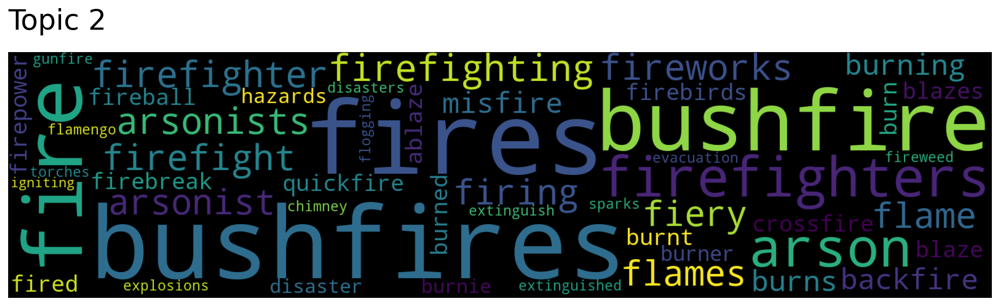

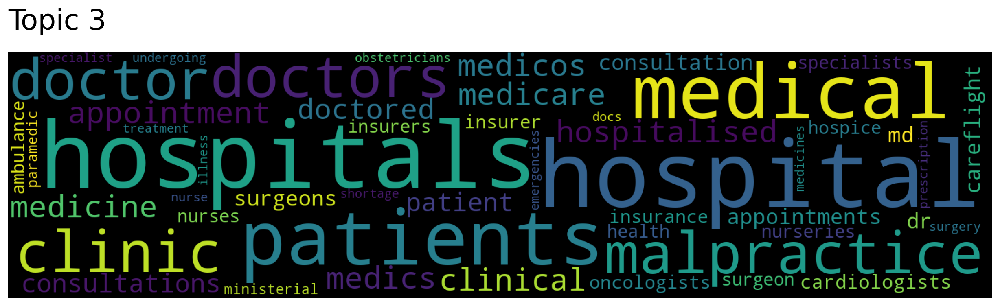

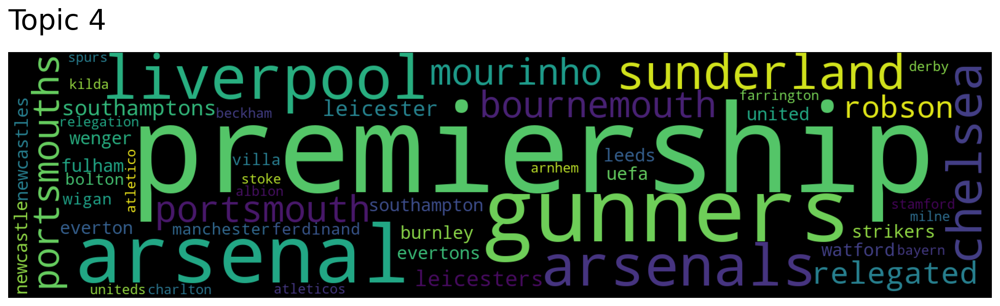

...

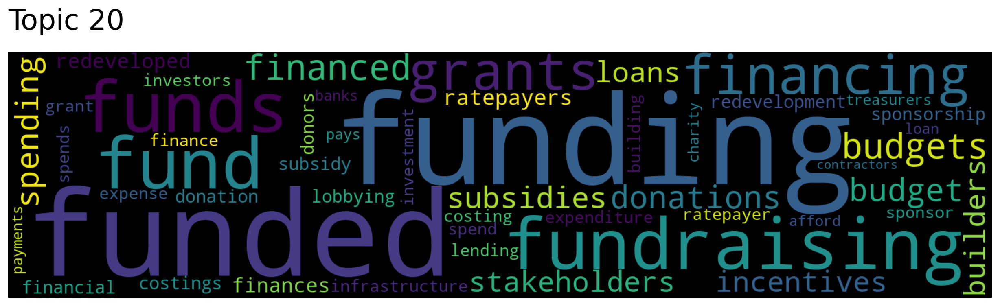

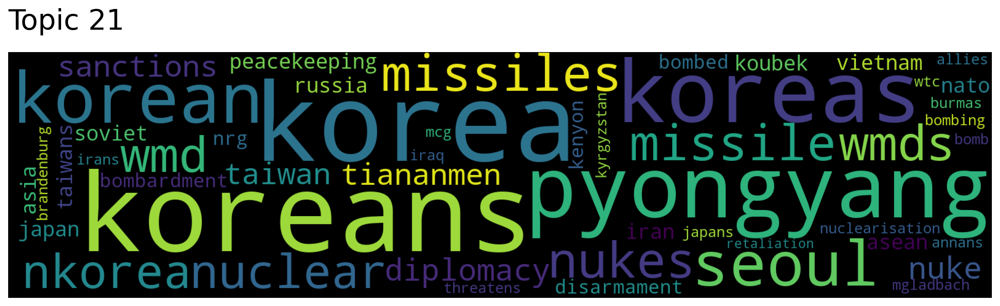

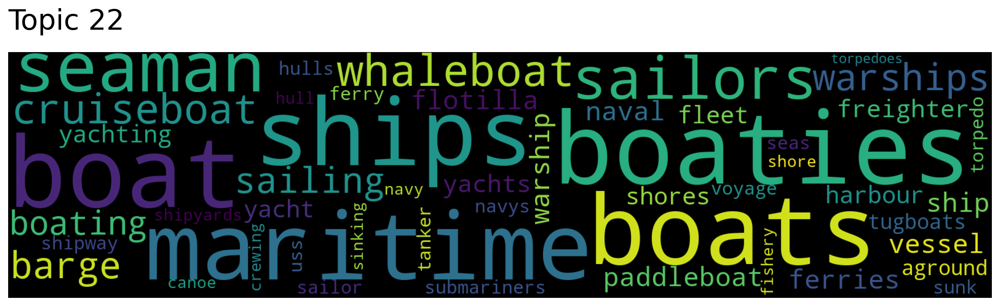

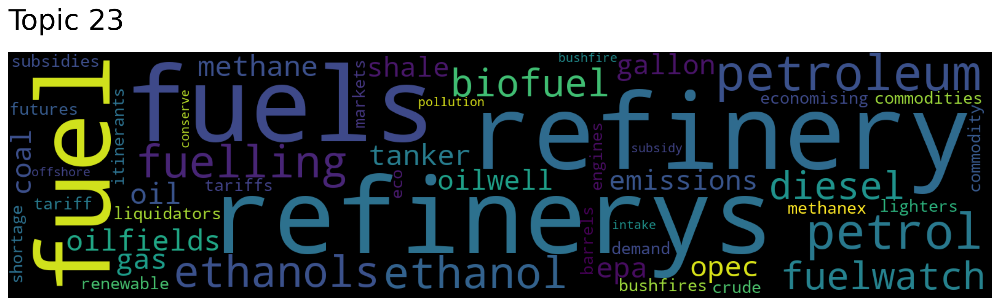

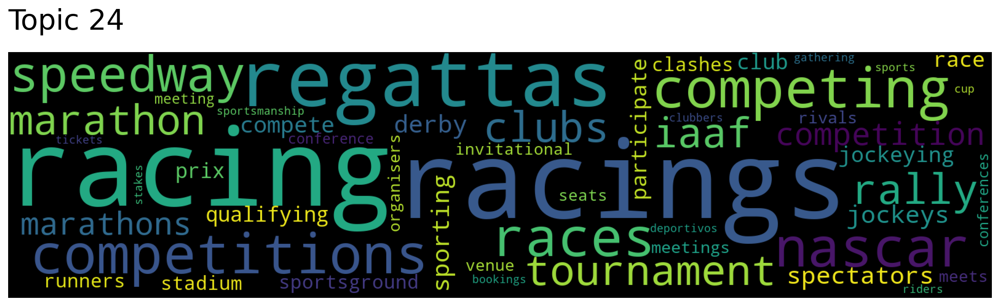

In [39]:
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)